In [1]:
import os
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import random
import math
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder
from object_detection.utils import config_util
%matplotlib inline
os.getcwd()

'c:\\Users\\thana\\Desktop\\TheShit\\DurianSang\\Mobnet'

In [2]:
image_x = 640
image_y = 360

path = {
    'stickcam_folder':os.path.join('dataset', 'stickcam'),
    'checkpoint_path': os.path.join('Model', 'my_stick_ssd_mobnet2')
}

file = {
    'topcam_removeBG_model':os.path.join('Model', 'RemoveBottomBackground2.h5'),
    'sidecam_removeBG_model':os.path.join('Model', 'RemoveBackgroundVer9.h5'),
    'bottomcam_removeBG_model':os.path.join('Model', 'RemoveStickBackground001.h5'),
    'pipeline_config':os.path.join(path['checkpoint_path'], 'pipeline.config'),
    'label_map':os.path.join('annotations', 'stick_label_map.pbtxt')
}


In [12]:
category_index = label_map_util.create_category_index_from_labelmap(file['label_map'])
# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file(file['pipeline_config'])
detection_model = model_builder.build(model_config=configs['model'], is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
ckpt.restore(os.path.join(path['checkpoint_path'], 'ckpt-201')).expect_partial()

@tf.function
def detect_fn(image):
    image, shapes = detection_model.preprocess(image)
    prediction_dict = detection_model.predict(image, shapes)
    detections = detection_model.postprocess(prediction_dict, shapes)
    return detections


# Stick Camera Function

In [21]:
def Stick_detection(image):
    ##### return image with MODEL shape #####
    src = cv.resize(image, (320, 320))
    [hight,width,_] = src.shape
    image_np = np.array(src).astype(np.uint8)
    
    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections = detect_fn(input_tensor)
    
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy() for key, value in detections.items()}
    detections['num_detections'] = num_detections
    
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
    
    label_id_offset = 1
    image_np_with_detections = image_np.copy()
    
    viz_utils.visualize_boxes_and_labels_on_image_array(
                image_np_with_detections,
                detections['detection_boxes'],
                detections['detection_classes'] + label_id_offset,
                detections['detection_scores'],
                category_index,
                use_normalized_coordinates = True,
                max_boxes_to_draw = 2,
                min_score_thresh = (0.2),
                agnostic_mode = False)
    

    if(detections['detection_scores'][0] >= 0.1):
        detected = True
    else:
        detected = False
    
    ymin = np.array(detections['detection_boxes'][0][0] * hight)
    xmin = np.array(detections['detection_boxes'][0][1] * width)
    ymax = np.array(detections['detection_boxes'][0][2] * hight)
    xmax = np.array(detections['detection_boxes'][0][3] * width)
    center_x = ((xmax - xmin)/2) + xmin
    center_y = ((ymax - ymin)/2) + ymin
    
    return image_np_with_detections

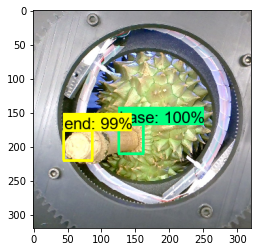

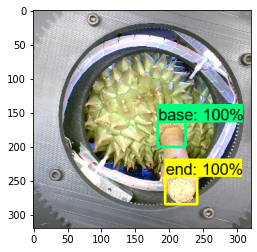

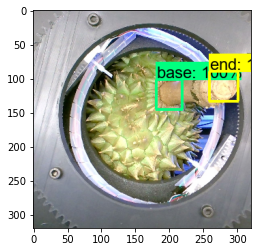

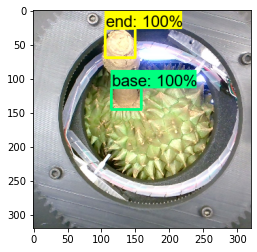

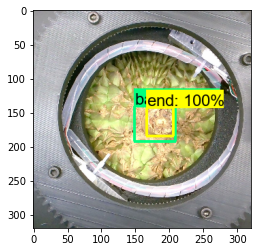

...

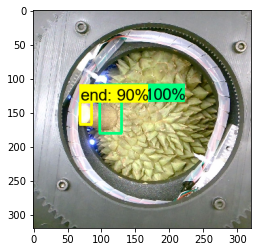

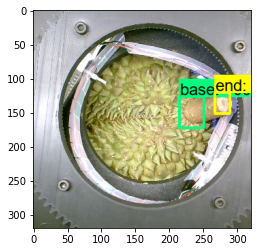

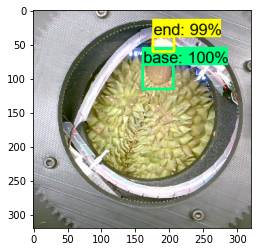

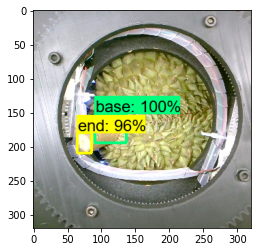

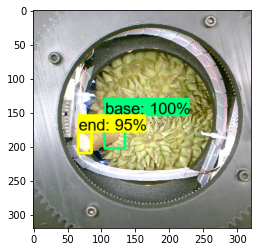

In [22]:
stickcam_folder = next(os.walk(path['stickcam_folder']))[1]
center_x = 960
center_y = 540

for i in stickcam_folder:
    stickcam_folder_path = os.path.join(path['stickcam_folder'], str(i))
    stickcam_pic_name = next(os.walk(stickcam_folder_path))[2]


    for j in range(len(stickcam_pic_name)):
        stickcam_pic_path = os.path.join(stickcam_folder_path, stickcam_pic_name[j])
        stickcam_image = cv.imread(stickcam_pic_path, cv.IMREAD_COLOR)
        stickcam_image = stickcam_image[center_y - 540:center_y + 540 ,center_x - 540:center_x + 540]
        stick_detection = Stick_detection(stickcam_image)
        plt.imshow(cv.cvtColor(stick_detection, cv.COLOR_BGR2RGB))
        plt.show()